Tests for Kinematic-Environment
===============================


Version | Author
------------ | -------------
0.1 | Björn Hein, extendig work from Gergely Soti

License is based on Creative Commons: Attribution-NonCommercial 4.0 International (CC BY-NC 4.0) (pls. check: http://creativecommons.org/licenses/by-nc/4.0/)

# Setting up a simple example using an articulated robot

In [1]:
from IPPlanarManipulator import PlanarJoint, PlanarRobot
from IPEnvironmentKin import KinChainCollisionChecker, planarRobotVisualize
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon, LineString
from shapely import plotting

obst = dict()
obst["obs1"] = LineString([(-2, 0), (-0.8, 0)]).buffer(0.5)
obst["obs2"] = LineString([(2, 0), (2, 1)]).buffer(0.2)
obst["obs3"] = LineString([(-1, 2), (1, 2)]).buffer(0.1)


## 2-DOF Example

Create environment with robot and obstacle.

In [2]:
r = PlanarRobot(n_joints=2)
environment = KinChainCollisionChecker(r, obst,fk_resolution=.2)

Draw start and goal position of robot within the environment

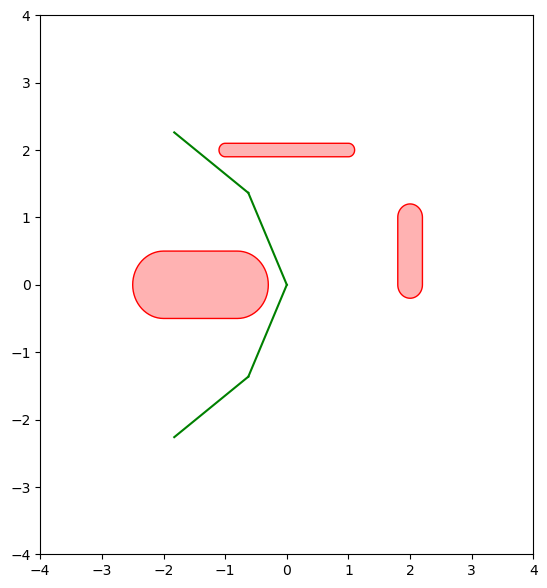

In [3]:
start_joint_pos = [2.0, 0.5]
end_joint_pos = [-2.0, -0.5]


fig_local = plt.figure(figsize=(14, 7))
## right figure for robot start position
ax1 = fig_local.add_subplot(1, 2, 1)
ax1.set_xlim([-4,4])
ax1.set_ylim([-4,4])
environment.drawObstacles(ax1, True)
r.move(start_joint_pos)
planarRobotVisualize(r, ax1)
r.move(end_joint_pos)
planarRobotVisualize(r, ax1)

Plan path with LazyPRM

In [4]:
import IPLazyPRM
import IPVISLazyPRM

lazyPRM = IPLazyPRM.LazyPRM(environment)
lazyConfig = dict()
lazyConfig["initialRoadmapSize"] = 20
lazyConfig["updateRoadmapSize"]  = 5 
lazyConfig["kNearest"] = 15
lazyConfig["maxIterations"] = 15

start_joint_pos = [2.0, 0.5]
end_joint_pos = [-2.0, -0.5]

start = [start_joint_pos]
goal  = [end_joint_pos]

## plan path from start ot goal
solution = lazyPRM.planPath(start, goal, lazyConfig)
print(solution)

['start', 4, 17, 'goal']


Animate the solution. When the robot is 2-Dof then Work-space and Configuration-space will be shown. please check function 'animateSolution' in module 'IPEnvironmentKin.py'.

In [5]:
from IPEnvironmentKin import animateSolution
animateSolution(lazyPRM, environment, solution, IPVISLazyPRM.lazyPRMVisualize)

## Extend to a 3-Dof robot

In [ ]:
r = PlanarRobot(n_joints=3)
limits = [[-3.14,3.14],[-3.14,3.14],[-3.14,3.14]]
environment = KinChainCollisionChecker(r, obst,limits=limits, fk_resolution=.2)

In [ ]:
start_joint_pos = [2.0, 0.5, 0.5]
end_joint_pos = [-2.0, -0.5, -0.5]

In [ ]:
fig_local = plt.figure(figsize=(14, 7))
ax1 = fig_local.add_subplot(1, 2, 1)
ax1.set_xlim([-4,4])
ax1.set_ylim([-4,4])
environment.drawObstacles(ax1, True)
r.move(start_joint_pos)
planarRobotVisualize(r, ax1)
r.move(end_joint_pos)
planarRobotVisualize(r, ax1)

In [ ]:
lazyPRM = IPLazyPRM.LazyPRM(environment)
lazyConfig = dict()
lazyConfig["initialRoadmapSize"] = 20
lazyConfig["updateRoadmapSize"]  = 5 
lazyConfig["kNearest"] = 15
lazyConfig["maxIterations"] = 50

start = [start_joint_pos]
goal  = [end_joint_pos]
## plan path from start ot goal
solution = lazyPRM.planPath(start, goal, lazyConfig)
print(solution)


Remark: As the robot is now 3-Dof only the Work-space will be shown:

In [ ]:
animateSolution(lazyPRM, environment, solution, IPVISLazyPRM.lazyPRMVisualize)

## Extend to a 4-Dof robot
(Attention: could take several minutes for planning, especially if not a Lazy-variant)

In [ ]:
r = PlanarRobot(n_joints=4)
limits = [[-3.14,3.14],[-3.14,3.14],[-3.14,3.14],[-3.14,3.14]]
environment = KinChainCollisionChecker(r, obst,limits=limits, fk_resolution=.2)

In [ ]:
start_joint_pos = [2.0, 0.5, 0.5,0.5]
end_joint_pos = [-2.0, -0.5, -0.5,-0.5]


fig_local = plt.figure(figsize=(14, 7))
## right figure for robot start position
ax1 = fig_local.add_subplot(1, 2, 1)
ax1.set_xlim([-4,4])
ax1.set_ylim([-4,4])
environment.drawObstacles(ax1, True)
r.move(start_joint_pos)
planarRobotVisualize(r, ax1)
r.move(end_joint_pos)
planarRobotVisualize(r, ax1)

In [ ]:
lazyPRM = IPLazyPRM.LazyPRM(environment)
lazyConfig = dict()
lazyConfig["initialRoadmapSize"] = 100
lazyConfig["updateRoadmapSize"]  = 30 
lazyConfig["kNearest"] = 15
lazyConfig["maxIterations"] = 50

start = [start_joint_pos]
goal  = [end_joint_pos]
## plan path from start ot goal
solution = lazyPRM.planPath(start, goal, lazyConfig)
print(solution)


In [ ]:
animateSolution(lazyPRM, environment, solution, IPVISLazyPRM.lazyPRMVisualize, workSpaceLimits=[[-5,5],[-5,5]])

# What about different planners?

In [ ]:
import IPVisibilityPRM
import IPVISVisibilityPRM

In [ ]:
visbilityConfig = dict()
visbilityConfig["ntry"] = 100

visibilityPRM = IPVisibilityPRM.VisPRM(environment)
start = [start_joint_pos]
goal  = [end_joint_pos]
## plan path from start ot goal
solution = visibilityPRM.planPath(start, goal, visbilityConfig)
print(solution)

In [ ]:
from IPEnvironmentKin import animateSolution
animateSolution(visibilityPRM, environment, solution, IPVISVisibilityPRM.visibilityPRMVisualize, workSpaceLimits=[[-5,5],[-5,5]])